<a href="https://colab.research.google.com/github/Kudasai03/Data-Analysis-Programming/blob/main/LTPTDL_Nhom10_SleepHealth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Chương I, II: Tổng quan và Xử lý dữ liệu đầu vào**

In [ ]:
import matplotlib.pyplot         as plt
import numpy                     as np
import pandas                    as pd
import scipy.stats               as stats
import seaborn                   as sns
import statsmodels.api           as sm
import statsmodels.formula.api as sms
import re
import pickle
import warnings
import plotly.express as px
import plotly.io as pio
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
%matplotlib inline
warnings.filterwarnings('ignore')
sns.set_theme(color_codes=True)

# Kiểm định
from statsmodels.formula.api     import ols
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy.stats import f_oneway
from statsmodels.stats.weightstats import ztest
from scipy.stats import chi2_contingency
from scipy.stats import chi2
from scipy.stats import levene

In [ ]:
# df = pd.read_csv('Sleep_health_and_lifestyle_dataset.csv')
# df.head()

In [ ]:
# df.info()

## 2.1 Tạo cột mới

In [ ]:
# # Tạo điều kiện cho np.select
# conditions = [
#     (df['Sleep Disorder'] == 'Sleep Apnea'),
#     (df['Sleep Disorder'] == 'Insomnia'),
#     (df['Stress Level'] > 6)
# ]
# # Tạo giá trị tương ứng cho từng điều kiện
# values = [
#     np.floor(np.random.uniform(3, 6, len(df))),
#     np.floor(np.random.uniform(1, 3, len(df))),
#     np.floor(np.random.uniform(0, 2, len(df)))
# ]
# # Mặc định cho các trường hợp khác
# default_value = np.floor(np.random.uniform(0, 1, len(df)))
# # Thêm cột 'Awakening' dựa trên điều kiện
# df['Awakening'] = np.select(conditions, values, default_value)

In [ ]:
# num_columns_to_make_missing = int(np.round(np.random.uniform(1, 3)))
# columns_to_make_missing = np.random.choice(df.columns, num_columns_to_make_missing, replace=False)

# # Tạo giá trị thiếu trong mỗi cột, trừ 'Sleep disorder'
# for column in columns_to_make_missing:
#     if column != 'Sleep Disorder':
#         column_size = len(df[column])
#         missing_rate = np.random.uniform(0.01, 0.10)
#         num_missing_values = int(column_size * missing_rate)
#         missing_indices = np.random.choice(df.index, num_missing_values, replace=False)
#         df.loc[missing_indices, column] = np.nan

# print(df)


In [ ]:
## Check trùng lặp
# df.duplicated().sum()

# **Chương III: Tiền  xử lý bộ dữ liệu**

In [ ]:
# df.head()

In [ ]:
# categorical_vars = df.select_dtypes(include=['object']).columns
# numeric_vars = df.select_dtypes(exclude=['object']).columns
# print("Biến categorical:")
# print(categorical_vars)
# print("\nBiến numerical:")
# print(numeric_vars)

### **Chỉnh dạng cột bộ dữ liệu**

**Blood Pressure**

In [ ]:
# df['Blood Pressure'].describe()

Chỉnh dạng cột dữ liệu

In [ ]:
# df[['Blood Pressure 1', 'Blood Pressure 2']] = df['Blood Pressure'].str.split('/', expand=True).astype(int)
# df.drop(columns='Blood Pressure', inplace=True)
# df.head()

**BMI Category**

In [ ]:
# df['BMI Category'].unique()

In [ ]:
# # Thay thế Normal Weight to Normal
# df['BMI Category'] = df['BMI Category'].replace('Normal Weight', 'Normal')
# df['BMI Category'].unique()

**Person ID**

In [ ]:
# # Vì cột này chỉ mang tính chất đánh số thứ tự không mang ý nghĩa thống kê => Drop
# df = df.drop(['Person ID'], axis=1)

In [ ]:
# # Cập nhật lại biến numerical
# numeric_vars = df.select_dtypes(exclude=['object']).columns
# print("\nBiến numerical:")
# print(numeric_vars)

### **Xử lý missing value**



In [ ]:
# df.isnull().sum()
# missing_data_summary=pd.DataFrame({'Missing Count': df.isnull().sum(),
#                                 'Missing Percentage': df.isnull().mean()*100})
# print(missing_data_summary)

**Heart Rate**

In [ ]:
# plt.figure(figsize = (15, 8))
# sns.countplot(x='Heart Rate', data=df)
# plt.title('Biểu đồ Distribution của biến Heart Rate')
# plt.show()

In [ ]:
# cols_in_row = len(numeric_vars)
# fig, axes = plt.subplots(2, cols_in_row // 2, figsize=((2 * cols_in_row, 8)))
# axes = axes.flatten()
# for i, numeric_var in enumerate(numeric_vars):
#     sns.scatterplot(data=df, x='Heart Rate', y=numeric_var, ax=axes[i])
#     axes[i].set_title(f'Scatter plot for {numeric_var}')
# plt.tight_layout()
# plt.show()

In [ ]:
# from sklearn.linear_model import LinearRegression

# # Tách dữ liệu thành hai phần: một phần chứa missing value và phần còn lại
# df_missing = df[df['Heart Rate'].isnull()]
# df_not_missing = df.dropna(subset=['Heart Rate', 'Daily Steps', 'Quality of Sleep'])

# # Chia dữ liệu có giá trị thành features (X) và target (y)
# X_train = df_not_missing[['Daily Steps', 'Quality of Sleep']]
# y_train = df_not_missing['Heart Rate']

# # Sử dụng mô hình hồi quy tuyến tính để dự đoán giá trị missing
# model = LinearRegression()
# model.fit(X_train, y_train)
# predicted_values = model.predict(df_missing[['Daily Steps', 'Quality of Sleep']])

# # Làm tròn giá trị dự đoán thành số nguyên
# predicted_values_rounded = np.round(predicted_values).astype(int)
# df.loc[df['Heart Rate'].isnull(), 'Heart Rate'] = predicted_values_rounded

In [ ]:
# plt.figure(figsize = (15, 8))
# sns.countplot(x='Heart Rate', data=df)
# plt.title('Biểu đồ Distribution của biến Heart Rate')
# plt.show()

**Awakening**

In [ ]:
# plt.figure(figsize = (15, 8))
# sns.countplot(x='Awakening', data=df)
# plt.title('Distribution of Awakening')
# plt.show()

In [ ]:
# df['Awakening'].fillna(df['Awakening'].mode()[0], inplace=True)

In [ ]:
# df.isnull().sum()
# missing_data_summary = pd.DataFrame({'Missing Count': df.isnull().sum()
#                       , 'Missing Percentage': df.isnull().mean() * 100})
# print(missing_data_summary)

## **Xử lý outlier**

In [ ]:
# plt.figure(figsize=(15, 8))
# for i, var in enumerate(numeric_vars):
#     plt.subplot(2, len(numeric_vars)//2, i+1)
#     sns.boxplot(y=df[var])
#     plt.title(f'Boxplot of {var}')
# plt.tight_layout()
# plt.show()

- Ở đây Heart Rate của một người bình thường hoàn toàn có thể trên 80 vậy nên chúng ta sẽ kiểm định xem những giá trị trên 80 này có sự ảnh hưởng tới biến mục tiêu của bộ dữ liệu là Sleep Disoder hay không

In [ ]:
# df['Sleep_Disorders'] = df['Sleep Disorder'].replace({'None': 1, 'Insomnia': 2, 'Sleep Apnea': 2})

In [ ]:
# grouped_data = df.groupby(['Heart Rate', 'Sleep Disorder']).size().reset_index(name='Count')
# print(grouped_data)

In [ ]:
# import scipy.stats as stats
# import pandas as pd

# # Chia dữ liệu thành hai nhóm dựa trên Heart Rate
# above_78 = df[df['Heart Rate'] > 78]['Sleep_Disorders']
# below_78 = df[df['Heart Rate'] <= 78]['Sleep_Disorders']

# # Thực hiện kiểm định t-test đối với hai nhóm
# t_statistic, p_value = stats.ttest_ind(above_78, below_78, equal_var=False)

# # In kết quả
# print(f'T-statistic: {t_statistic}\nP-value: {p_value}')

# # Kiểm tra giả thuyết
# alpha = 0.05
# if p_value < alpha:
#     print("Có bằng chứng để bác bỏ giả thuyết null. Có sự khác biệt đáng kể giữa hai nhóm.")
# else:
#     print("Không đủ bằng chứng để bác bỏ giả thuyết null. Không có sự khác biệt đáng kể giữa hai nhóm.")


In [ ]:
# plt.figure(figsize=(10, 6))
# sns.histplot(data=df, x='Heart Rate', hue='Sleep Disorder', multiple='stack', bins=10)
# plt.title('Biểu đồ phân phối của biến Heart Rate theo bệnh về giấc ngủ')
# plt.xlabel('Heart Rate')
# plt.ylabel('Số lượng')
# plt.show()

- Vì những giá trị này có ý nghĩa thống kê => không xử lý outlier này

## **Bộ dư liệu sau khi xử lý**

In [ ]:
# plt.style.use('seaborn-white')
# sns.pairplot(data=df,hue='Sleep Disorder',palette='mako')
# plt.legend()
# plt.show()

In [ ]:
# df.describe().style.background_gradient(cmap='BuPu')

In [ ]:
# # CSV file
# df.to_csv('Data_after_EDA.csv', index=False)

# Link phần xử lý dữ liệu đầu vào:
https://colab.research.google.com/drive/15N_tO43FhvTM6r3f8hUkfmk4lWn7Wocn

# **EDA**

In [ ]:
df = pd.read_csv('/content/Data_after_EDA.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 374 entries, 0 to 373
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Gender                   374 non-null    object 
 1   Age                      374 non-null    int64  
 2   Occupation               374 non-null    object 
 3   Sleep Duration           374 non-null    float64
 4   Quality of Sleep         374 non-null    int64  
 5   Physical Activity Level  374 non-null    int64  
 6   Stress Level             374 non-null    int64  
 7   BMI Category             374 non-null    object 
 8   Heart Rate               374 non-null    float64
 9   Daily Steps              374 non-null    int64  
 10  Sleep Disorder           374 non-null    object 
 11  Awakening                374 non-null    float64
 12  Blood Pressure 1         374 non-null    int64  
 13  Blood Pressure 2         374 non-null    int64  
dtypes: float64(3), int64(7), o

In [ ]:
df

,Gender,Age,Occupation,Sleep Duration,Quality of Sleep,Physical Activity Level,Stress Level,BMI Category,Heart Rate,Daily Steps,Sleep Disorder,Awakening,Blood Pressure 1,Blood Pressure 2
0,Male,27,Software Engineer,6.1,6,42,6,Overweight,77.0,4200,None,0.0,126,83
1,Male,28,Doctor,6.2,6,60,8,Normal,75.0,10000,None,0.0,125,80
2,Male,28,Doctor,6.2,6,60,8,Normal,75.0,10000,None,0.0,125,80
3,Male,28,Sales Representative,5.9,4,30,8,Obese,85.0,3000,Sleep Apnea,5.0,140,90
4,Male,28,Sales Representative,5.9,4,30,8,Obese,85.0,3000,Sleep Apnea,3.0,140,90
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
369,Female,59,Nurse,8.1,9,75,3,Overweight,68.0,7000,Sleep Apnea,3.0,140,95
370,Female,59,Nurse,8.0,9,75,3,Overweight,68.0,7000,Sleep Apnea,5.0,140,95
371,Female,59,Nurse,8.1,9,75,3,Overweight,68.0,7000,Sleep Apnea,3.0,140,95
372,Female,59,Nurse,8.1,9,75,3,Overweight,68.0,7000,Sleep Apnea,3.0,140,95


In [ ]:
df.isnull().sum()
missing_data_summary=pd.DataFrame({'Missing Count': df.isnull().sum(),
                                'Missing Percentage': df.isnull().mean()*100})
print(missing_data_summary)

                         Missing Count  Missing Percentage
Gender                               0                 0.0
Age                                  0                 0.0
Occupation                           0                 0.0
Sleep Duration                       0                 0.0
Quality of Sleep                     0                 0.0
Physical Activity Level              0                 0.0
Stress Level                         0                 0.0
BMI Category                         0                 0.0
Heart Rate                           0                 0.0
Daily Steps                          0                 0.0
Sleep Disorder                       0                 0.0
Awakening                            0                 0.0
Blood Pressure 1                     0                 0.0
Blood Pressure 2                     0                 0.0


- Tổng quan heatmap

<Axes: >

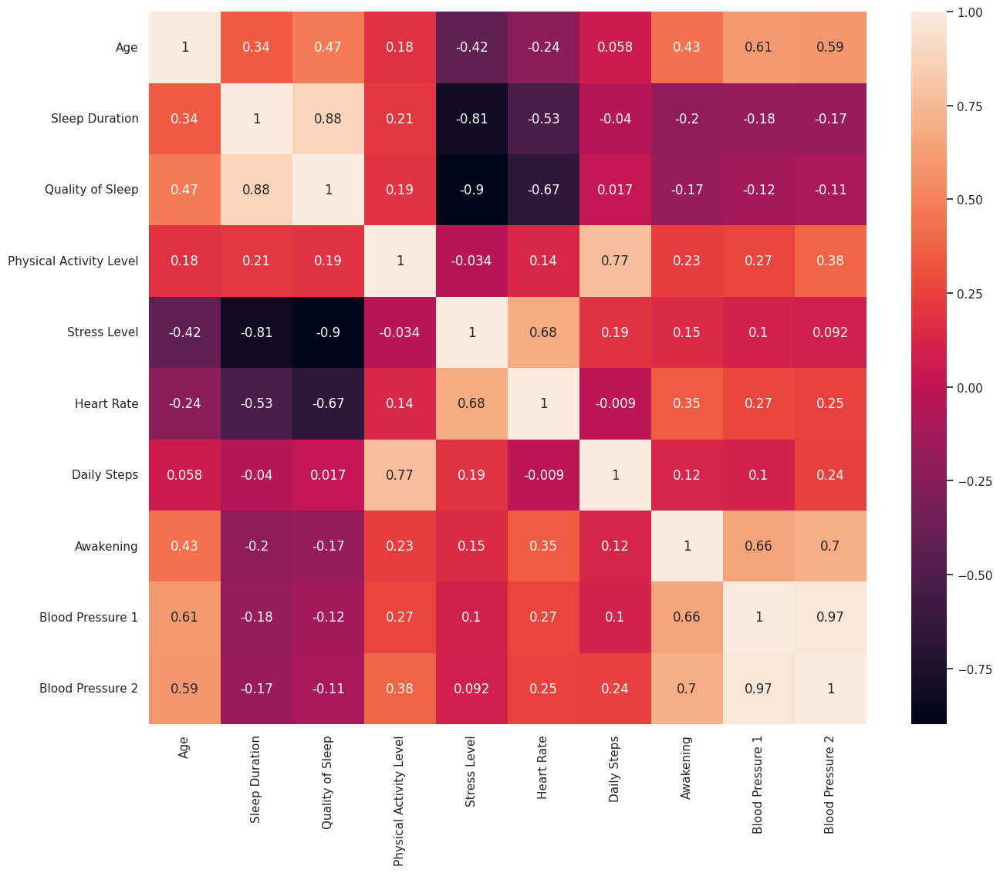

In [ ]:
plt.figure(figsize=(15, 12))
sns.heatmap(df.corr(), fmt='.2g', annot=True)

# **Chương IV. PHÂN TÍCH BỘ DỮ LIỆU NGHIÊN CỨU:**

## **4.1 Phân tích đơn biến:**

https://colab.research.google.com/drive/1wNrsMz3DUhIxXqbX9HMrwC0EE_NE7432?usp=sharing

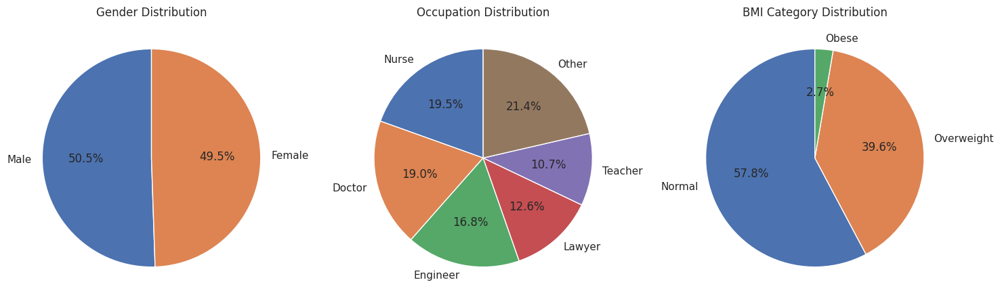

In [ ]:
max_categories = 5
cat_vars = ['Gender', 'Occupation', 'BMI Category']
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15, 15))
for i, var in enumerate(cat_vars):
    if i < len(axs.flat):
        cat_counts = df[var].value_counts()
        if len(cat_counts) > max_categories:
            cat_counts_top = cat_counts[:max_categories]
            cat_counts_other = pd.Series(cat_counts[max_categories:].sum(), index=['Other'])
            cat_counts = cat_counts_top.append(cat_counts_other)
        axs.flat[i].pie(cat_counts, labels=cat_counts.index, autopct='%1.1f%%', startangle=90)
        axs.flat[i].set_title(f'{var} Distribution')
fig.tight_layout()
plt.show()

## **4.2 Phân tích đa biến:**


### 4.2.1 Các yếu tố ảnh hưởng tới chất lượng giấc ngủ:

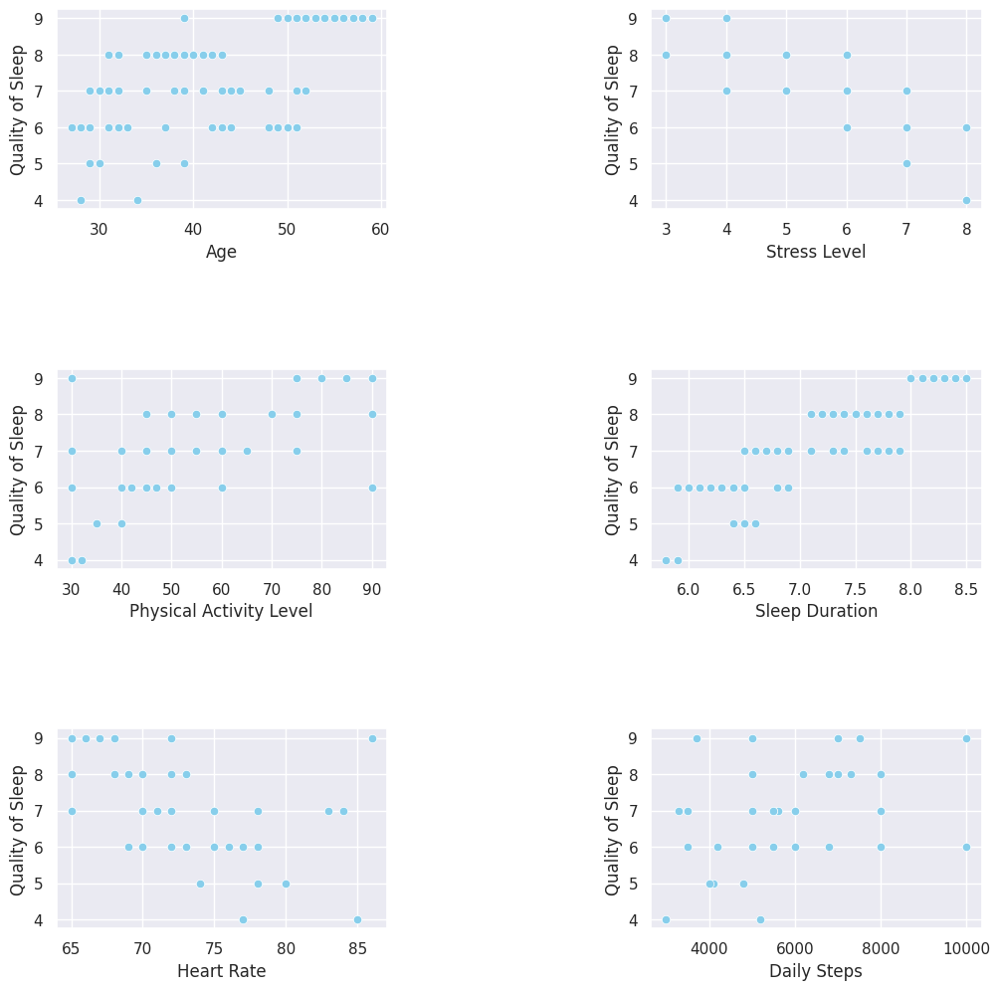

In [ ]:
fig, axs = plt.subplots(3, 2, figsize=(12, 12))
plt.subplots_adjust(wspace=0.8, hspace=0.8)
numeric_x = ["Age", "Stress Level", "Physical Activity Level", "Sleep Duration", "Heart Rate", "Daily Steps"]

for i, cat in enumerate(numeric_x):
    sns.scatterplot(x=df[cat], y=df["Quality of Sleep"], color='skyblue', ax=axs[int(i / 2), i % 2])

plt.show()

Kiểm định Heart Rate có tương quan với Quality of Sleep

In [ ]:
from scipy.stats import pearsonr
X = df['Heart Rate']
Y = df['Quality of Sleep']

# Thực hiện kiểm định Pearson
corr, p_value = pearsonr(X, Y)

# In kết quả
print(f'Pearson correlation coefficient: {corr}')
print(f'P-value: {p_value}')

# Kiểm tra giả thuyết
if p_value < 0.05:
    print('Có mối tương quan tuyến tính giữa 2 biến Heart Rate và Quality of Sleep')
else:
    print('Không có mối tương quan tuyến tính giữa 2 biến Heart Rate và Quality of Sleep')

Pearson correlation coefficient: -0.6668589064754076
P-value: 1.8747152724093885e-49
Có mối tương quan tuyến tính giữa 2 biến Heart Rate và Quality of Sleep


### 4.2.2 Các yếu tố ảnh hưởng tới bệnh về giấc ngủ:

- Giới tính và nghề nghiệp

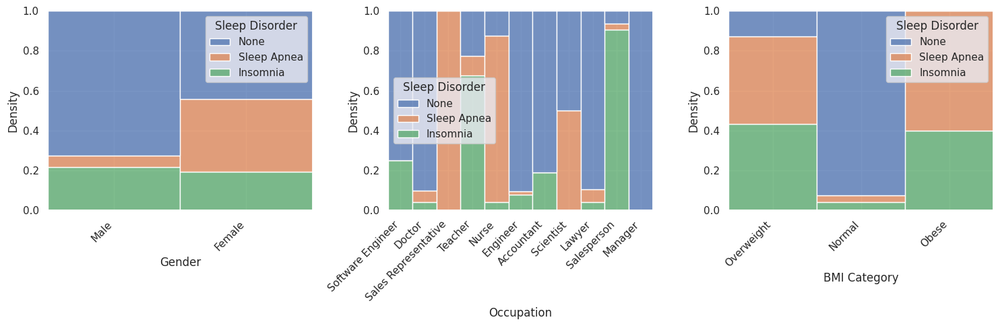

In [ ]:
import warnings
warnings.filterwarnings("ignore")
cat_vars = ['Gender', 'Occupation', 'BMI Category']
fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))
axs = axs.flatten()
for i, var in enumerate(cat_vars):
    sns.histplot(x=var, hue='Sleep Disorder', data=df, ax=axs[i],
    multiple="fill", kde=False, element="bars", fill=True, stat='density')
    axs[i].set_xticklabels(df[var].unique(), rotation=45, ha='right')
    axs[i].set_xlabel(var)
fig.tight_layout()
plt.show()

- Stress Lever
- Kiểm định Stress Level ảnh hưởng tới Sleep Disorder




In [ ]:
df['Stress_Level'] = df['Stress Level'].replace({
    3.0: 'Thấp',
    4.0: 'Thấp',
    5.0: 'Trung bình',
    6.0: 'Trung bình',
    7.0: 'Cao',
    8.0: 'Cao'})

In [ ]:
Marital=df[['Sleep Disorder','Stress_Level']]
crosstab = pd.crosstab(Marital["Sleep Disorder"], Marital["Stress_Level"])
crosstab

Stress_Level,Cao,Thấp,Trung bình
Sleep Disorder,,,
Insomnia,44,25,8
None,36,83,100
Sleep Apnea,40,33,5


In [ ]:
contingency_table = pd.crosstab(df['Stress Level'], df['Sleep Disorder'])
chi2_stat, p_value, _, _ = chi2_contingency(contingency_table)

print(f"Chi-squared statistic: {chi2_stat}")
print(f"P-value: {p_value}")

alpha = 0.05
if p_value < alpha:
    print("Có đủ bằng chứng để bác bỏ H0. Có sự tương quan giữa 2 biến")
else:
    print("Không đủ bằng chứng để bác bỏ H0. Không có sự tương quan giữa 2 biến")

Chi-squared statistic: 240.19936847934278
P-value: 6.221717380449499e-46
Có đủ bằng chứng để bác bỏ H0. Có sự tương quan giữa 2 biến


- Tuổi tác

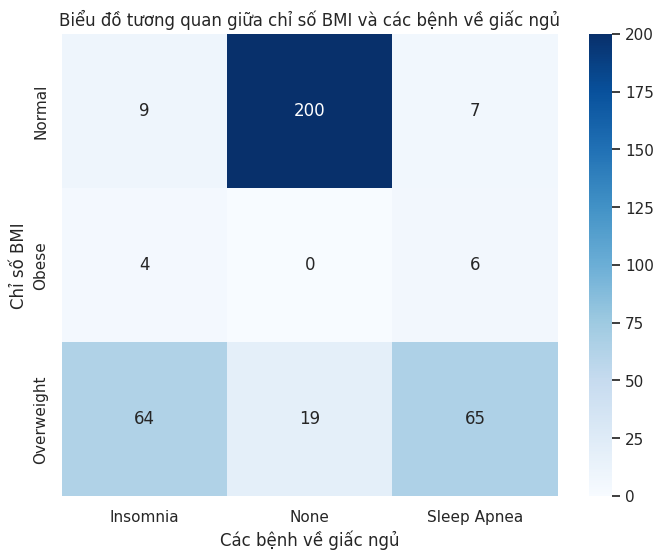

In [ ]:
cross_tab = pd.crosstab(df['BMI Category'], df['Sleep Disorder'])
plt.figure(figsize=(8, 6))
sns.heatmap(cross_tab, annot=True, cmap='Blues', fmt='d', cbar=True,
            xticklabels=cross_tab.columns, yticklabels=cross_tab.index)
plt.title('Biểu đồ tương quan giữa chỉ số BMI và các bệnh về giấc ngủ')
plt.xlabel('Các bệnh về giấc ngủ')
plt.ylabel('Chỉ số BMI')
plt.show()

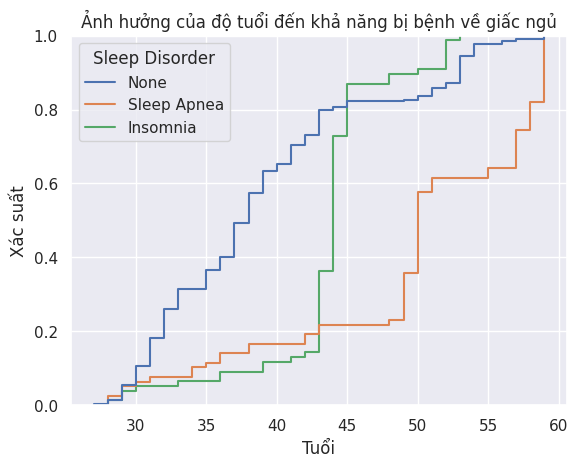

In [ ]:
sns.ecdfplot(data=df, x='Age', hue='Sleep Disorder')
plt.xlabel('Tuổi')
plt.ylabel('Xác suất')
plt.title('Ảnh hưởng của độ tuổi đến khả năng bị bệnh về giấc ngủ', fontsize=12)
plt.show()

### 4.2.3 Các yếu tố khác:

- Tuổi

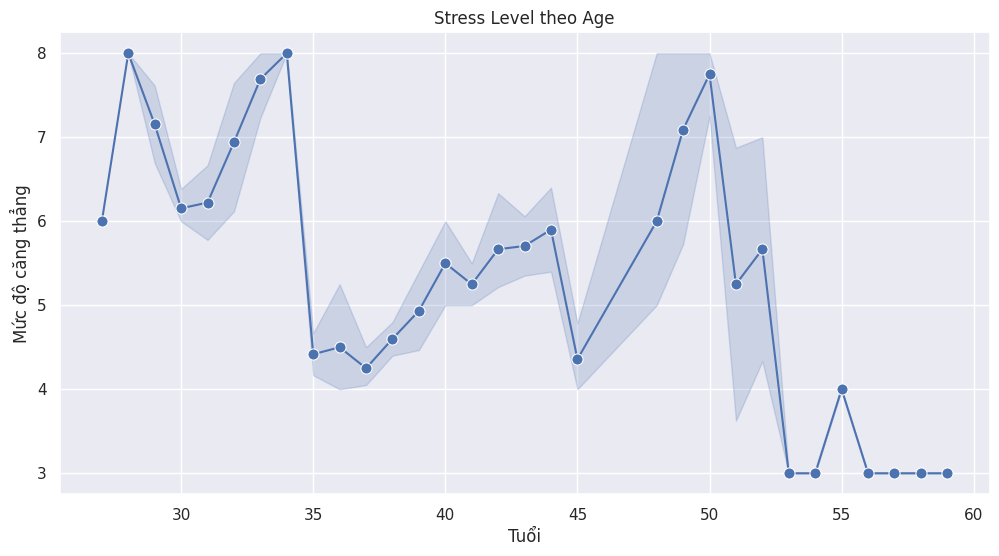

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(x="Age", y="Stress Level", data=df, marker="o", markersize=8)
plt.xlabel('Tuổi')
plt.ylabel('Mức độ căng thẳng')
plt.title("Stress Level theo Age")
plt.show()

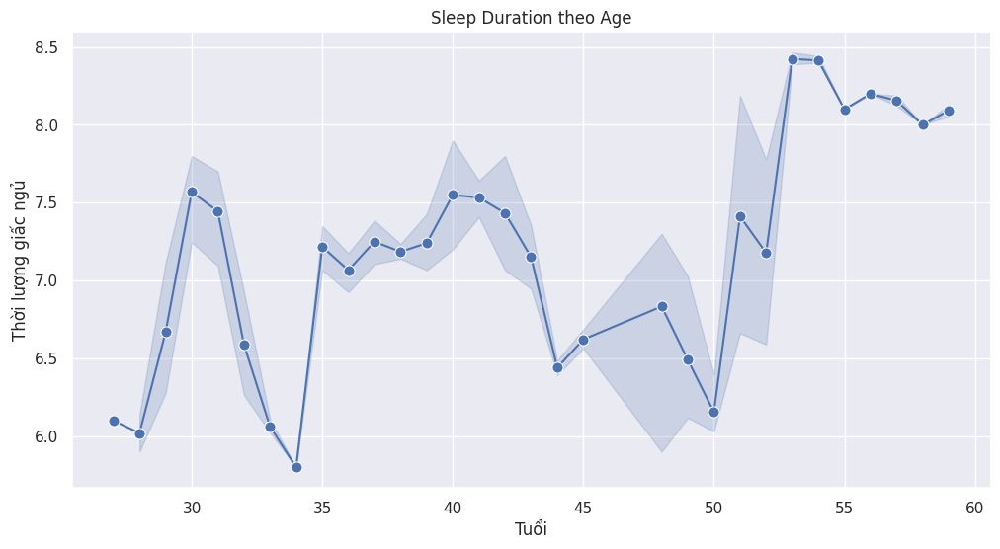

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(x="Age", y="Sleep Duration", data=df, marker="o", markersize=8)
plt.xlabel('Tuổi')
plt.ylabel('Thời lượng giấc ngủ')
plt.title("Sleep Duration theo Age")
plt.show()

- Tỷ lệ stress

In [ ]:
from IPython.display import HTML
import plotly.express as px

fig = px.box(df, x=df['Gender'], y=df['Stress Level'],
             title="Phân phối của Stress Level theo Gender", color = 'Gender')
fig.update_layout(
    xaxis_title="Giới tính",
    yaxis_title="Mức độ căng thẳng",
    width=1000,
    height=600)
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

In [ ]:
average_quality = df.groupby('BMI Category')['Quality of Sleep'].mean().reset_index()

# Tạo biểu đồ trung bình chất lượng giấc ngủ theo chỉ số BMI
fig = px.bar(average_quality, x='BMI Category', y='Quality of Sleep',
             title="Trung bình chất lượng Giấc Ngủ theo chỉ số BMI",
             color ='BMI Category')

fig.update_layout(
    xaxis_title="BMI",
    yaxis_title="Trung bình chất lượng Giấc Ngủ",
    width=1000,
    height=400)
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

In [ ]:
average_quality = df.groupby('Occupation')['Stress Level'].mean().reset_index()

# Tạo biểu đồ trung bình chất lượng giấc ngủ theo chỉ số BMI
fig = px.bar(average_quality,  x='Occupation', y='Stress Level',
             title="Mức độ căng thẳng theo ngành nghề",
             color ='Occupation')

fig.update_layout(
    xaxis_title="Ngành nghề",
    yaxis_title="Mức độ căng thẳng",
    width=1000,
    height=600)
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

# **Chương V: Kiểm định:**

## **5.1 Các yếu tố ảnh hưởng tới thời lượng và chất lượng giấc ngủ:**

### **5.1.1 Giới tính**

#### a. Giới tính và thời lượng giấc ngủ

In [ ]:
df['Gender'].value_counts()

Male      189
Female    185
Name: Gender, dtype: int64

In [ ]:
df['Sleep Duration']

0      6.1
1      6.2
2      6.2
3      5.9
4      5.9
      ... 
369    8.1
370    8.0
371    8.1
372    8.1
373    8.1
Name: Sleep Duration, Length: 374, dtype: float64

In [ ]:
fig = px.box(df, x=df['Gender'], y=df['Sleep Duration'],
             title="Phân phối của Sleep Duration theo Gender", color = 'Gender')
fig.update_layout(
    xaxis_title="Giới tính",
    yaxis_title="Thời gian ngủ",
    width=1000,
    height=600)
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

**Giả thuyết: Nam và nữ có thời lượng giấc ngủ là như nhau:**
- H0: {Sleep Duration} Nam = {Sleep Duration}Nữ
- H1: {Sleep Duration} Nam # {Sleep Duration}Nữ

In [ ]:
df2 = df[['Gender', 'Sleep Duration']]
male_group = df2[df2["Gender"] == "Male"]["Sleep Duration"].dropna()
female_group = df2[df2["Gender"] == "Female"]["Sleep Duration"].dropna()
# Thực hiện kiểm định t-test
t_statistic, p_value = stats.ttest_ind(male_group, female_group, equal_var=False)
print("T-statistic:", t_statistic)
print("Giá trị p:", p_value)
alpha = 0.05
if p_value < alpha:
    print("Có đủ bằng chứng để bác bỏ H0.")
else:
    print("Không đủ bằng chứng để bác bỏ H0.")

T-statistic: -2.356536840262248
Giá trị p: 0.018997711592424273
Có đủ bằng chứng để bác bỏ H0.


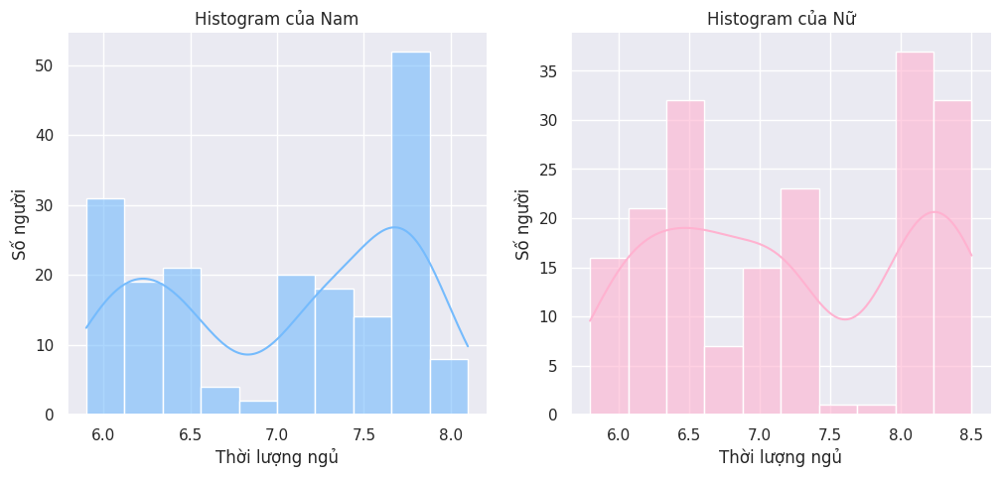

In [ ]:
# Vẽ biểu đồ minh họa
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
sns.histplot(male_group, bins=10, color=sns.xkcd_rgb['sky blue'], alpha=0.6, kde=True, ax=ax1)
ax1.set_title('Histogram của Nam')
ax1.set_xlabel('Thời lượng ngủ')
ax1.set_ylabel('Số người')

sns.histplot(female_group, bins=10, color=sns.xkcd_rgb['powder pink'], alpha=0.6, kde=True, ax=ax2)
ax2.set_title('Histogram của Nữ')
ax2.set_xlabel('Thời lượng ngủ')
ax2.set_ylabel('Số người')
sns.despine()
plt.show()

#### b. Giới tính và chất lượng giấc ngủ:

In [ ]:
fig = px.box(df, x=df['Gender'], y=df['Quality of Sleep'],
             title="Biểu đồ phân phối Quality of Sleep theo Gende", color = 'Gender')
fig.update_layout(
    xaxis_title="Giới tính",
    yaxis_title="Chất lượng giấc ngủ")
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

In [ ]:
df2 = df[['Gender', 'Quality of Sleep']]
male_group = df2[df2["Gender"] == "Male"]["Quality of Sleep"].dropna()
female_group = df2[df2["Gender"] == "Female"]["Quality of Sleep"].dropna()
# Thực hiện kiểm định t-test
t_statistic, p_value = stats.ttest_ind(male_group, female_group, equal_var=False)
print("T-statistic:", t_statistic)
print("Giá trị p:", p_value)
alpha = 0.05
if p_value < alpha:
    print("Có đủ bằng chứng để bác bỏ H0.")
else:
    print("Không đủ bằng chứng để bác bỏ H0.")

T-statistic: -5.859317976055214
Giá trị p: 1.078122839334259e-08
Có đủ bằng chứng để bác bỏ H0.


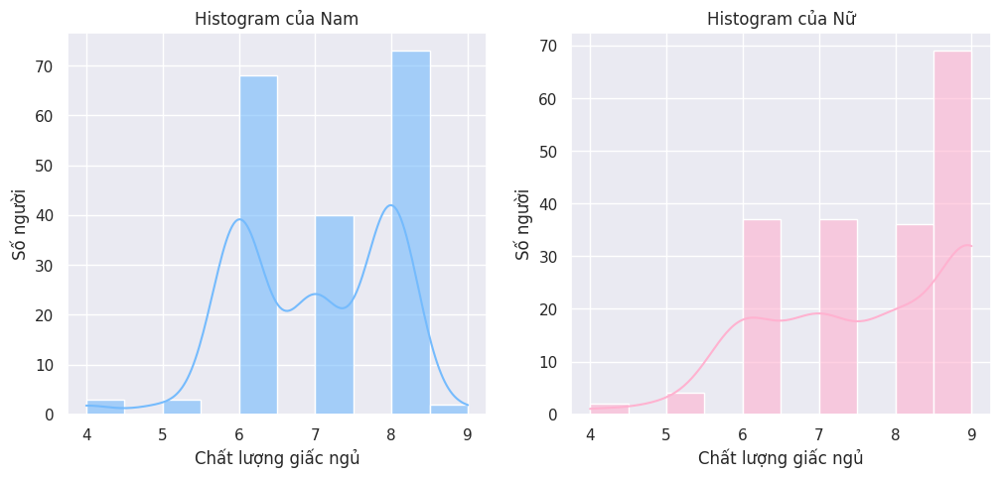

In [ ]:
# Vẽ biểu đồ minh họa
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))
sns.histplot(male_group, bins=10, color=sns.xkcd_rgb['sky blue'], alpha=0.6, kde=True, ax=ax1)
ax1.set_title('Histogram của Nam')
ax1.set_xlabel('Chất lượng giấc ngủ')
ax1.set_ylabel('Số người')

sns.histplot(female_group, bins=10, color=sns.xkcd_rgb['powder pink'], alpha=0.6, kde=True, ax=ax2)
ax2.set_title('Histogram của Nữ')
ax2.set_xlabel('Chất lượng giấc ngủ')
ax2.set_ylabel('Số người')
plt.show()

### **5.1.2 Huyết áp tới chất lượng giấc ngủ:**

In [ ]:
# Tính hệ số tương quan Pearson và p-value
r, p_value = pearsonr(df['Blood Pressure 1'], df['Sleep Duration'])
r = round(r, 2)
p_value = round(p_value, 4)

print(f"Pearson correlation coefficient (r): {r}")
print(f"P-value: {p_value}")
if np.sign(r) == -1:
    s = "âm"
elif np.sign(r) == 1:
    s = "dương"
if np.abs(r) < 0.1:
    print('Huyết áp tâm thu "Blood Pressure 1" và thời lượng giấc ngủ không có mối quan hệ tương quan tuyến tính')
elif 0.1 <= np.abs(r) < 0.3:
    print('Huyết áp tâm thu "Blood Pressure 1" và thời lượng giấc ngủ có mối tương quan tuyến tính', s, 'rất yếu')
elif 0.3 <= np.abs(r) < 0.5:
    print('Huyết áp tâm thu "Blood Pressure 1" và thời lượng giấc ngủ có mối tương quan tuyến tính', s, 'trung bình')
else:
    print('Huyết áp tâm thu "Blood Pressure 1" và thời lượng giấc ngủ có mối tương quan tuyến tính', s, 'mạnh')

Pearson correlation coefficient (r): -0.18
P-value: 0.0005
Huyết áp tâm thu "Blood Pressure 1" và thời lượng giấc ngủ có mối tương quan tuyến tính âm rất yếu


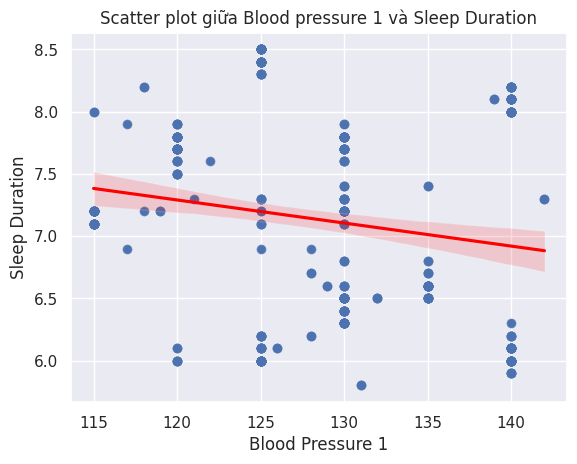

In [ ]:
sns.scatterplot(x='Blood Pressure 1', y='Sleep Duration', data=df)
plt.title('Scatter plot giữa Blood pressure 1 và Sleep Duration')
sns.regplot(x='Blood Pressure 1', y='Sleep Duration', data=df, line_kws={'color': 'red'})
plt.show()

## **5.2 Các yếu tố ảnh hưởng tới bệnh về giấc ngủ:**


### **5.2.1  Nam và nữ có tỉ lệ mắc bệnh về giấc ngủ là như nhau:**
- H0: {Sleep Disorder} Nam = {Sleep Disorder}Nữ
- H1: {Sleep Disorder} Nam # {Sleep Disorder}Nữ

In [ ]:
Marital=df[['Sleep Disorder','Gender']]
crosstab = pd.crosstab(Marital["Sleep Disorder"], Marital["Gender"])
crosstab

Gender,Female,Male
Sleep Disorder,,
Insomnia,36,41
None,82,137
Sleep Apnea,67,11


In [ ]:
contingency_table = pd.crosstab(df['Gender'], df['Sleep Disorder'])
chi2_stat, p_value, _, _ = chi2_contingency(contingency_table)
print(f"Chi-squared statistic: {chi2_stat}")
print(f"P-value: {p_value}")
alpha = 0.05
if p_value < alpha:
    print("Có đủ bằng chứng để bác bỏ H0.")
else:
    print("Không đủ bằng chứng để bác bỏ H0.")

Chi-squared statistic: 54.30602007353474
P-value: 1.6128633524576768e-12
Có đủ bằng chứng để bác bỏ H0.


### **5.2.2 BMI và bệnh về giấc ngủ:**

In [ ]:
##----------------------------------------------------
## Các giả thuyết kiểm định
##    H0: Chỉ số BMI và rối loạn giấc ngủ là ĐỘC LẬP
##    Ha: Chỉ số BMI và rối loạn giấc ngủ là PHỤ THUỘC lẫn nhau
##----------------------------------------------------
alpha            = .05
confidence_level = (1-alpha)

In [ ]:
contingency_table = pd.crosstab(df['BMI Category'], df['Sleep Disorder'])
chi2_stat, p_value, _, _ = chi2_contingency(contingency_table)

print(f"Chi-squared statistic: {chi2_stat}")
print(f"P-value: {p_value}")

alpha = 0.05
if p_value < alpha:
    print("Có đủ bằng chứng để bác bỏ H0.")
else:
    print("Không đủ bằng chứng để bác bỏ H0.")

Chi-squared statistic: 245.66534355746683
P-value: 5.5883512097923584e-52
Có đủ bằng chứng để bác bỏ H0.


In [ ]:
cross_tab = pd.crosstab(df['BMI Category'], df['Sleep Disorder'])
new_df = cross_tab.reset_index()
new_df.columns.name = None
new_df

,BMI Category,Insomnia,None,Sleep Apnea
0,Normal,9,200,7
1,Obese,4,0,6
2,Overweight,64,19,65


In [ ]:
table = []
for index, row in new_df.iterrows():
  lst = row.values[1:].tolist()
  table.append(lst)
table

[[9, 200, 7], [4, 0, 6], [64, 19, 65]]

In [ ]:
stat, p, dof, expected = stats.chi2_contingency(table)
## Kết luận theo phương pháp p-value (trị số p)
if (p < alpha):
    print(f'Trị số p = {p:.4f} < {alpha:.4f} nên bác bỏ H0 ==> (Chỉ số BMI, Rối loạn giấc ngủ) PHỤ THUỘC')
else:
    print(f'Trị số p = {p:.4f} >= {alpha:.4f} KHÔNG bác bỏ H0 ==> (Chỉ số BMI, Rối loạn giấc ngủ) ĐỘC LẬP')

Trị số p = 0.0000 < 0.0500 nên bác bỏ H0 ==> (Chỉ số BMI, Rối loạn giấc ngủ) PHỤ THUỘC


In [ ]:
sleep_disorder_mapping = {
    'Sleep Apnea': 'Chứng ngưng thở',
    'Insomnia': 'Chứng mất ngủ',
    'None': 'Không có'
}

bmi_category_mapping = {
    'Obese': 'Béo phì',
    'Overweight': 'Béo phì',
    'Normal': 'Bình thường'
}

# Apply mappings to create new columns
df['Sleep Disorder Mapped'] = df['Sleep Disorder'].map(sleep_disorder_mapping)
df['BMI Category Mapped'] = df['BMI Category'].map(bmi_category_mapping)

# Create a violin plot using Plotly Express with mapped values
fig = px.violin(df, x='Sleep Disorder Mapped', y='BMI Category Mapped',
                title="Biểu đồ phân phối giữa BMI Category và Sleep Disorder")

# Update layout with axis titles and set background color to none (transparent)
fig.update_layout(
    xaxis_title="Các bệnh về giấc ngủ",
    yaxis_title="Chỉ số BMI",
    width=1000,
    height=500)

html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

In [ ]:
df = df.drop(['BMI Category Mapped','Sleep Disorder Mapped'], axis = 1)

### **5.2.3 Những người trên 40 tuổi dễ mắc bệnh về giấc ngủ hơn tập còn lại:**

In [ ]:
df['Sleep_Disorders'] = df['Sleep Disorder'].replace({
    'None': 0,
    'Insomnia': 1,
    'Sleep Apnea': 1,})

In [ ]:
import pandas as pd
from statsmodels.stats.weightstats import ztest

# Tạo hai nhóm dữ liệu
group_over_40 = df[df['Age'] > 40]['Sleep_Disorders']
group_under_40 = df[df['Age'] <= 40]['Sleep_Disorders']

# Thực hiện kiểm định t-test
t_statistic, p_value = ztest(group_over_40, group_under_40, value=0, alternative='two-sided')

# In kết quả
print(f'T-statistic: {t_statistic}\nP-value: {p_value}')

# Kiểm tra giả thuyết
alpha = 0.05
if p_value < alpha:
    print("Có bằng chứng để bác bỏ giả thiết null. Có sự khác biệt đáng kể giữa hai nhóm.")
else:
    print("Không đủ bằng chứng để bác bỏ giả thiết null. Không có sự khác biệt đáng kể giữa hai nhóm.")


T-statistic: 11.345336369021489
P-value: 7.8224860663594e-30
Có bằng chứng để bác bỏ giả thiết null. Có sự khác biệt đáng kể giữa hai nhóm.


### **5.2.4 Nhịp tim tới bệnh về giấc ngủ:**

In [ ]:
df['Sleep_Disorderss'] = df['Sleep Disorder'].replace({
    'None': 'Không',
    'Insomnia': 'Có',
    'Sleep Apnea': 'Có',})

In [ ]:
# Tạo hai nhóm dữ liệu
group_none = df[df['Sleep_Disorderss'] == 'Không']['Heart Rate']
group_not_none = df[df['Sleep_Disorderss'] == 'Có']['Heart Rate']
# Thực hiện kiểm định t-test
t_statistic, p_value = ztest(group_none, group_not_none, value=0, alternative='two-sided')
# In kết quả
print(f'T-statistic: {t_statistic}\nP-value: {p_value}')

# Kiểm tra giả thuyết
alpha = 0.05
if p_value < alpha:
    print("Có bằng chứng để bác bỏ giả thiết null. Có sự khác biệt đáng kể giữa hai nhóm.")
else:
    print("Không đủ bằng chứng để bác bỏ giả thiết null. Không có sự khác biệt đáng kể giữa hai nhóm.")


T-statistic: -6.189171328145092
P-value: 6.048131888471746e-10
Có bằng chứng để bác bỏ giả thiết null. Có sự khác biệt đáng kể giữa hai nhóm.


In [ ]:
fig = px.box(df, x=df['Sleep_Disorderss'], y=df['Heart Rate'],
             title="Phân phối của tình trạng không và có bệnh về giấc ngủ theo Heart Rate", color = 'Sleep_Disorderss')
fig.update_layout(
    xaxis_title="Bệnh về giấc ngủ",
    yaxis_title="'Nhịp tim",
    width=1000,
    height=600)
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

### **5.2.5 Thời gian thể dục trong ngày với bệnh về giấc ngủ:**

In [ ]:
df['Sleep_Disorder'] = df['Sleep Disorder'].replace({
    'None': 0,
    'Insomnia': 1,
    'Sleep Apnea': 2,})

In [ ]:
# Tạo mô hình OLS
model = sm.OLS.from_formula('Q("Physical Activity Level") ~ C(Sleep_Disorder)', data=df).fit()
residuals = model.resid
# Thực hiện kiểm định Levene trên residuals
levene_statistic, levene_p_value = levene(*[residuals[df['Sleep_Disorder'] == occupation]
                                          for occupation in df['Sleep_Disorder'].unique()])
print("Levene Statistic:", levene_statistic)
print("P-value (Levene):", levene_p_value)

alpha = 0.05
if levene_p_value < alpha:
    print("Có bằng chứng để bác bỏ giả định về phương sai đồng nhất.")
else:
    print("Không có bằng chứng để bác bỏ giả định về phương sai đồng nhất.")

Levene Statistic: 26.637945259436496
P-value (Levene): 1.549139850268813e-11
Có bằng chứng để bác bỏ giả định về phương sai đồng nhất.


In [ ]:
sleep_disorder_mapping = {
    'Sleep Apnea': 'Chứng ngưng thở',
    'Insomnia': 'Chứng mất ngủ',
    'None': 'Không có'
}
df['Sleep Disorder Mapped'] = df['Sleep Disorder'].map(sleep_disorder_mapping)
# plt.figure(figsize=(8, 8))
# sns.boxplot(x='Sleep Disorder Mapped', y='Physical Activity Level', data=df)
# plt.xlabel('Các bệnh về giấc ngủ')
# plt.ylabel('Thời lượng tập luyện mỗi ngày')
# plt.title('Biểu đồ phân phối của Sleep Disorder theo Physical Activity Level')
# plt.show()

fig = px.box(df, x=df['Sleep Disorder Mapped'], y=df['Physical Activity Level'],
             title="Biểu đồ phân phối của Sleep Disorder theo Physical Activity Level", color = 'Sleep Disorder Mapped')
fig.update_layout(
    xaxis_title="Bệnh về giấc ngủ",
    yaxis_title="'Thời lượng tập luyện mỗi ngày",
    width=1000,
    height=600)
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

In [ ]:
df = df.drop('Sleep Disorder Mapped', axis = 1)

## **5.3 Các yếu tố sức khỏe khác:**

### **5.3.1 Độ tuổi và chỉ số BMI:**

In [ ]:
model = sm.OLS.from_formula('Q("Age") ~ C(Q("BMI Category"))', data=df).fit()
# Lấy residuals
residuals = model.resid
# Thực hiện kiểm định Levene trên residuals
levene_statistic, levene_p_value = levene(*[residuals[df['BMI Category'] == category] for category in df['BMI Category'].unique()])

print("Levene Statistic:", levene_statistic)
print("P-value (Levene):", levene_p_value)
alpha = 0.05
if levene_p_value < alpha:
    print("Có bằng chứng để bác bỏ giả định về phương sai đồng nhất.")
else:
    print("Không có bằng chứng để bác bỏ giả định về phương sai đồng nhất.")

Levene Statistic: 1.5485012024226694
P-value (Levene): 0.21393699486209478
Không có bằng chứng để bác bỏ giả định về phương sai đồng nhất.


In [ ]:
from scipy.stats import f_oneway
# Ví dụ với Age và Occupation
grouped_data = [df['Age'][df['BMI Category'] == occupation] for occupation in df['BMI Category'].unique()]
# Thực hiện kiểm định ANOVA
f_statistic, p_value = f_oneway(*grouped_data)
print("F-statistic:", f_statistic)
print("P-value:", p_value)
alpha = 0.05
if p_value < alpha:
    print("Có đủ bằng chứng để bác bỏ H0.")
else:
    print("Không đủ bằng chứng để bác bỏ H0.")

F-statistic: 73.48591878915192
P-value: 1.3033764297692233e-27
Có đủ bằng chứng để bác bỏ H0.


In [ ]:
from statsmodels.stats.multicomp import pairwise_tukeyhsd
data_for_anova = pd.DataFrame({'Age': df['Age'], 'BMI_Category': df['BMI Category']})
# Thực hiện hậu kiểm Turkey
tukey_result = pairwise_tukeyhsd(endog=data_for_anova['Age'], groups=data_for_anova['BMI_Category'], alpha=0.05)
# In kết quả hậu kiểm Turkey
print(tukey_result)

  Multiple Comparison of Means - Tukey HSD, FWER=0.05  
group1   group2   meandiff p-adj   lower  upper  reject
-------------------------------------------------------
Normal      Obese  -0.4722 0.9785 -6.0744 5.1299  False
Normal Overweight   9.4129    0.0  7.5648 11.261   True
 Obese Overweight   9.8851 0.0001  4.2263 15.544   True
-------------------------------------------------------


In [ ]:
bmi_category_mapping = {'Overweight':'Thừa cân', 'Normal':'Bình thường','Obese':'Béo phì'}
df['Chỉ số BMI'] = df['BMI Category'].map(bmi_category_mapping)

# plt.figure(figsize=(6, 4))
# sns.boxplot(x='Chỉ số BMI', y='Age', data=df, hue='Chỉ số BMI')
# plt.title('Biểu đồ phân phối của BMI Category theo Age')
# plt.xlabel('Chỉ số BMI')
# plt.ylabel('Tuổi')
# plt.show()

fig = px.box(df, x=df['Chỉ số BMI'], y=df['Age'],
             title="Biểu đồ phân phối của BMI Category theo Age", color = 'Chỉ số BMI')
fig.update_layout(
    xaxis_title="Chỉ số BMI",
    yaxis_title="'Tuổi")
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

df = df.drop('Chỉ số BMI', axis=1)

### **5.3.2 Số bước đi trong ngày và số lần thức giấc:**


In [ ]:
## Tính hệ số tương quan Pearson
r, _ = stats.pearsonr(df['Daily Steps'], df['Awakening'])
r = round(r, 2)
if np.sign(r) == -1:
    s = "âm"
elif np.sign(r) == 1:
    s = "dương"
if np.abs(r) < 0.1:
  print('Số bước đi trong ngày và số lần tỉnh giấc trong 1 đêm không có mối quan hệ tương quan tuyến tính')
elif np.abs(r) >= 0.1 and np.abs(r) < 0.3:
  print('Số bước đi trong ngày và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính',s, 'rất yếu')
elif np.abs(r) >= 0.3 and np.abs(r) < 0.5:
  print('Số bước đi trong ngày và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính',s, 'trung bình')
else:
  print('Số bước đi trong ngày và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính',s, 'mạnh')

Số bước đi trong ngày và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính dương rất yếu


In [ ]:
## Kiểm định T-test
##----------------------------------------------------
## Các giả thuyết kiểm định
##    H0: Số bước đi trong 1 ngày và số lần tỉnh giấc trong 1 đêm ĐỘC LẬP
##    Ha: Số bước đi trong 1 ngày và số lần tỉnh giấc trong 1 đêm PHỤ THUỘC lẫn nhau
##----------------------------------------------------
alpha            = .05
t_stat, p = stats.ttest_ind(df['Daily Steps'], df['Awakening'], equal_var=False, nan_policy='omit')

In [ ]:
## Kết luận theo phương pháp p-value (trị số p)
if (p < alpha):
    print(f'Trị số p = {p:.4f} < {alpha:.4f} nên bác bỏ H0 ==> (Số bước đi trong 1 ngày, Số lần tỉnh giấc trong 1 đêm) PHỤ THUỘC lẫn nhau')
else:
    print(f'Trị số p = {p:.4f} >= {alpha:.4f} KHÔNG bác bỏ H0 ==> (Số bước đi trong 1 ngày, Số lần tỉnh giấc trong 1 đêm) ĐỘC LẬP')

Trị số p = 0.0000 < 0.0500 nên bác bỏ H0 ==> (Số bước đi trong 1 ngày, Số lần tỉnh giấc trong 1 đêm) PHỤ THUỘC lẫn nhau


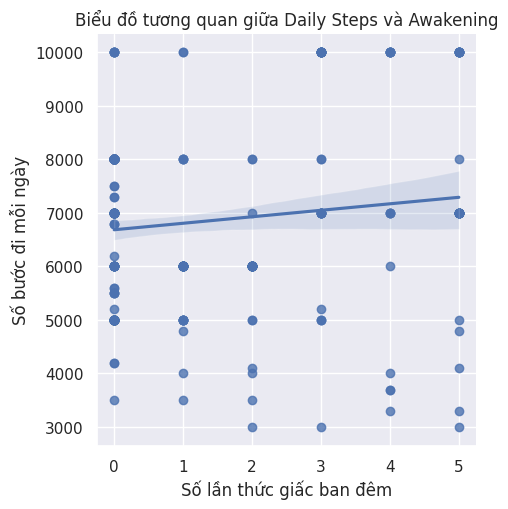

In [ ]:
sns.lmplot(x='Awakening', y='Daily Steps', data=df)

# Set title and axis labels for the lmplot
plt.title("Biểu đồ tương quan giữa Daily Steps và Awakening")
plt.xlabel("Số lần thức giấc ban đêm")
plt.ylabel('Số bước đi mỗi ngày')

# Show the lmplot
plt.show()

In [ ]:
fig = px.box(df, x=df['Awakening'], y=df['Daily Steps'],
             title="Biểu đồ phân phối của Awakening theo Daily Step", color = 'Awakening')
fig.update_layout(
    xaxis_title="Số lần thức giấc ban đêm",
    yaxis_title="'Số bước đi trong ngày",
    width=1000,
    height=600)
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

### **5.3.3 Hoạt động thể chất và số lần thức giấc:**

In [ ]:
## Tính hệ số tương quan Pearson
r, _ = stats.pearsonr(df['Physical Activity Level'], df['Awakening'])
r = round(r, 2)
if np.sign(r) == -1:
    s = "âm"
elif np.sign(r) == 1:
    s = "dương"
if np.abs(r) < 0.1:
  print('Mức độ hoạt động thể chất và số lần tỉnh giấc trong 1 đêm không có mối quan hệ tương quan tuyến tính')
elif np.abs(r) >= 0.1 and np.abs(r) < 0.3:
  print('Mức độ hoạt động thể chất và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính',s, 'rất yếu')
elif np.abs(r) >= 0.3 and np.abs(r) < 0.5:
  print('Mức độ hoạt động thể chất và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính',s, 'trung bình')
else:
  print('Mức độ hoạt động thể chất và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính',s, 'mạnh')


Mức độ hoạt động thể chất và số lần tỉnh giấc trong 1 đêm có mối tương quan tuyến tính dương rất yếu


In [ ]:
## Kiểm định T-test
##----------------------------------------------------
## Các giả thuyết kiểm định
##    H0: Số bước đi trong 1 ngày và số lần tỉnh giấc trong 1 đêm có mối quan hệ ĐỘC LẬP
##    Ha: Số bước đi trong 1 ngày và số lần tỉnh giấc trong 1 đêm có mối quan hệ PHỤ THUỘC lẫn nhau
##----------------------------------------------------
alpha            = .05
t_stat, p = stats.ttest_ind(df['Daily Steps'], df['Awakening'], equal_var=False, nan_policy='omit')

In [ ]:
## Kết luận theo phương pháp p-value (trị số p)
if (p < alpha):
    print(f'Trị số p = {p:.4f} < {alpha:.4f} nên bác bỏ H0 ==> (Số bước đi trong 1 ngày, Số lần tỉnh giấc trong 1 đêm) có mối quan hệ PHỤ THUỘC lẫn nhau')
else:
    print(f'Trị số p = {p:.4f} >= {alpha:.4f} KHÔNG bác bỏ H0 ==> (Số bước đi trong 1 ngày, Số lần tỉnh giấc trong 1 đêm) có mối quan hệ ĐỘC LẬP')

Trị số p = 0.0000 < 0.0500 nên bác bỏ H0 ==> (Số bước đi trong 1 ngày, Số lần tỉnh giấc trong 1 đêm) có mối quan hệ PHỤ THUỘC lẫn nhau


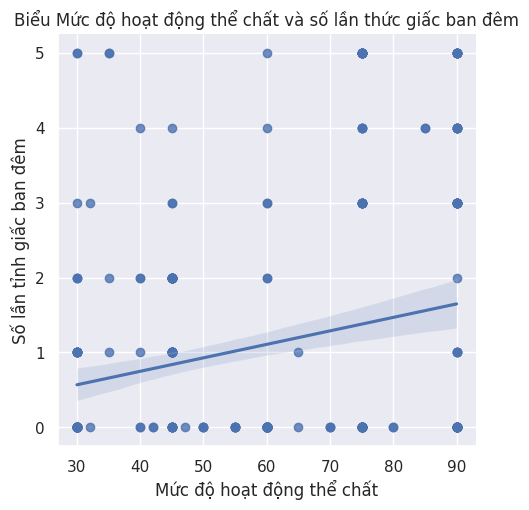

In [ ]:
# Show the lmplot
plt.show()

sns.lmplot(x='Physical Activity Level',y='Awakening', data=df)
plt.title('Biểu Mức độ hoạt động thể chất và số lần thức giấc ban đêm')
plt.ylabel('Số lần tỉnh giấc ban đêm')
plt.xlabel('Mức độ hoạt động thể chất')
plt.show()

### **5.3.4 Chất lượng giấc ngủ và độ tuổi:**

In [ ]:
from scipy.stats import spearmanr, kendalltau

# Spearman
correlation_coefficient, p_value = spearmanr(df['Quality of Sleep'], df['Age'])
print(f"Pearson correlation coefficient: {correlation_coefficient}")
print(f"P-value: {p_value}")

# Kiểm tra mức độ tương quan và ý nghĩa thống kê
if p_value < 0.05:
    print("Có tương quan có ý nghĩa thống kê")
else:
    print("Không có tương quan có ý nghĩa thống kê")

Pearson correlation coefficient: 0.4178102153067446
P-value: 3.1120629191378084e-17
Có tương quan có ý nghĩa thống kê


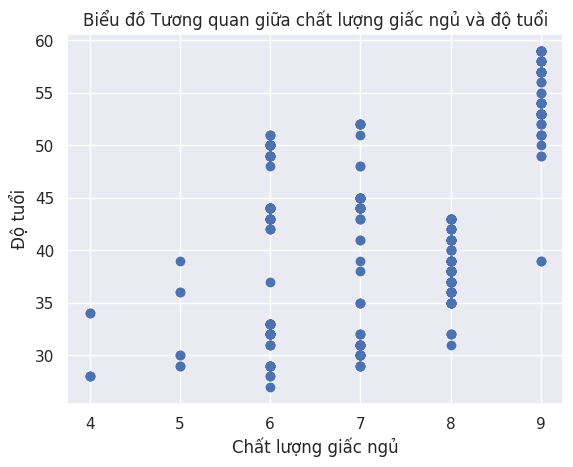

In [ ]:
plt.scatter(df['Quality of Sleep'], df['Age'])
plt.title('Biểu đồ Tương quan giữa chất lượng giấc ngủ và độ tuổi')
plt.xlabel('Chất lượng giấc ngủ')
plt.ylabel('Độ tuổi')
plt.show()

In [ ]:
fig = px.box(df, x=df['Awakening'], y=df['Physical Activity Level'],
             title="Biểu đồ phân phối của Awakening theo Physical Activity Level", color = 'Awakening')
fig.update_layout(
    xaxis_title="Số lần thức giấc ban đêm",
    yaxis_title="Thời gian tập thể thao mỗi ngày")
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

In [ ]:
# plt.figure(figsize=(8, 6))
# sns.boxplot(x='Awakening', y='Daily Steps', data=df)
# plt.xlabel('Số lần thức giấc mỗi đêm')
# plt.ylabel('Thời lượng tập luyện mỗi ngày')
# plt.title('Phân phối của Awakening theo Daily Steps')
# plt.show()

# **Chương VI: Xây dựng mô hình dự báo:**

Cài đặt các thư viện

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier

In [ ]:
df = pd.read_csv('/content/Data_after_EDA.csv')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 374 entries, 0 to 373
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   Gender                   374 non-null    object 
 1   Age                      374 non-null    int64  
 2   Occupation               374 non-null    object 
 3   Sleep Duration           374 non-null    float64
 4   Quality of Sleep         374 non-null    int64  
 5   Physical Activity Level  374 non-null    int64  
 6   Stress Level             374 non-null    int64  
 7   BMI Category             374 non-null    object 
 8   Heart Rate               374 non-null    float64
 9   Daily Steps              374 non-null    int64  
 10  Sleep Disorder           374 non-null    object 
 11  Awakening                374 non-null    float64
 12  Blood Pressure 1         374 non-null    int64  
 13  Blood Pressure 2         374 non-null    int64  
dtypes: float64(3), int64(7), o

### Mã hóa các cột Object

In [ ]:
df.drop(['Awakening'], axis=1, inplace=True)

- Dùng LabelEncoder để chuyển dạng những biến có giá trị là 'Object'

In [ ]:
for col in df.select_dtypes(include=['object']).columns:
    print(f"{col}: {df[col].unique()}")

Gender: ['Male' 'Female']
Occupation: ['Software Engineer' 'Doctor' 'Sales Representative' 'Teacher' 'Nurse'
 'Engineer' 'Accountant' 'Scientist' 'Lawyer' 'Salesperson' 'Manager']
BMI Category: ['Overweight' 'Normal' 'Obese']
Sleep Disorder: ['None' 'Sleep Apnea' 'Insomnia']


In [ ]:
# Mã hóa cột "Occupation" bằng one-hot encoding
df = pd.get_dummies(df, columns=['Occupation'], prefix='Occupation')
df = pd.get_dummies(df, columns=['BMI Category'], prefix='BMI Category')
print(df.head())

  Gender  Age  Sleep Duration  Quality of Sleep  Physical Activity Level  \
0   Male   27             6.1                 6                       42   
1   Male   28             6.2                 6                       60   
2   Male   28             6.2                 6                       60   
3   Male   28             5.9                 4                       30   
4   Male   28             5.9                 4                       30   

   Stress Level  Heart Rate  Daily Steps Sleep Disorder  Blood Pressure 1  \
0             6        77.0         4200           None               126   
1             8        75.0        10000           None               125   
2             8        75.0        10000           None               125   
3             8        85.0         3000    Sleep Apnea               140   
4             8        85.0         3000    Sleep Apnea               140   

   ...  Occupation_Manager  Occupation_Nurse  Occupation_Sales Representative  \

In [ ]:
# Mã hóa những cột còn lại bằng Label Encoder
label_encoder = LabelEncoder()
df['Gender'] = label_encoder.fit_transform(df['Gender'])
df['Sleep Disorder'] = label_encoder.fit_transform(df['Sleep Disorder'])

In [ ]:
df.head()

,Gender,Age,Sleep Duration,Quality of Sleep,Physical Activity Level,Stress Level,Heart Rate,Daily Steps,Sleep Disorder,Blood Pressure 1,...,Occupation_Manager,Occupation_Nurse,Occupation_Sales Representative,Occupation_Salesperson,Occupation_Scientist,Occupation_Software Engineer,Occupation_Teacher,BMI Category_Normal,BMI Category_Obese,BMI Category_Overweight
0,1,27,6.1,6,42,6,77.0,4200,1,126,...,0,0,0,0,0,1,0,0,0,1
1,1,28,6.2,6,60,8,75.0,10000,1,125,...,0,0,0,0,0,0,0,1,0,0
2,1,28,6.2,6,60,8,75.0,10000,1,125,...,0,0,0,0,0,0,0,1,0,0
3,1,28,5.9,4,30,8,85.0,3000,2,140,...,0,0,1,0,0,0,0,0,1,0
4,1,28,5.9,4,30,8,85.0,3000,2,140,...,0,0,1,0,0,0,0,0,1,0


### Chia tập Train-Test

In [ ]:
X = df.drop(['Sleep Disorder'], axis=1)
y = df['Sleep Disorder']

In [ ]:
# Chia thành các tập Train và Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=10)

### Cài đặt mô hình

- Cài đặt Pipline

In [ ]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('clf', RandomForestClassifier())])

- Dùng thư viện grid để thêm các tham số cho mô hình dự báo

In [ ]:
param_grid = [
    {'clf': [RandomForestClassifier()],
        'clf__n_estimators': [100, 200, 300,400],
        'clf__max_depth': [None, 5, 10,15],},

    {'clf': [LogisticRegression()],
        'clf__solver': ['liblinear', 'lbfgs'],
        'clf__C': [0.01,0.1, 1, 10],},

    {'clf': [KNeighborsClassifier()],
        'clf__n_neighbors': [3, 5, 7,9],},

    {'clf': [DecisionTreeClassifier()],
        'clf__max_depth': [None, 5, 10,15],}]

In [ ]:
# Sử dụng GridSearchCV để bổ sung các tham số
grid_search = GridSearchCV(pipeline, param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Lưu lại Best_model
best_model = grid_search.best_estimator_

# Chạy các thuật toán để tính Accuracy
models = [
    ('Random Forest', RandomForestClassifier()),
    ('Logistic Regression', LogisticRegression()),
    ('KNN', KNeighborsClassifier()),
    ('Decision Tree', DecisionTreeClassifier())]

accuracy_scores = []
for name, model in models:
    pipeline = Pipeline([
        ('scaler', StandardScaler()),
        ('clf', model)])
    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores.append(accuracy)

In [ ]:
import plotly.graph_objs as go

In [ ]:
# In kết quả dự báo dựa trên Accuracy Score
fig = go.Figure(data=go.Bar(x=[name for name, _ in models], y=accuracy_scores))
fig.update_layout(title='So sánh kết quả các Models',
                  xaxis=dict(title='Models'),
                  yaxis=dict(title='Accuracy Score'))
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

### **Đánh giá mô hình**

#### Kiểm tra Overfitting bằng Cross-Validation

In [ ]:
from sklearn.model_selection import cross_val_score

cv_scores = cross_val_score(best_model.named_steps['clf'], X_train, y_train, cv=5)
print("Cross-Validation Scores for Best Model:", cv_scores)
print("Mean CV Score for Best Model:", np.mean(cv_scores))

Cross-Validation Scores for Best Model: [0.9245283  0.84615385 0.96153846 0.90384615 0.90384615]
Mean CV Score for Best Model: 0.9079825834542816


In [ ]:
fig = go.Figure(data=[go.Bar(x=[f'Fold {i+1}' for i in range(len(cv_scores))], y=cv_scores, name='Cross-Validation Scores')])
fig.update_layout(title='So sánh kết quả các Models',
                  xaxis=dict(title='Models'),
                  yaxis=dict(title='Accuracy Score'))
html_path = 'temp-plot.html'
fig.write_html(html_path)
HTML(filename=html_path)

In [ ]:
from sklearn.metrics import accuracy_score

y_pred_test = best_model.predict(X_test)
test_accuracy = accuracy_score(y_test, y_pred_test)
print("Accuracy on Test Set:", test_accuracy)

Accuracy on Test Set: 0.9026548672566371


#### Đánh giá mô hình bằng Confusion Matrix

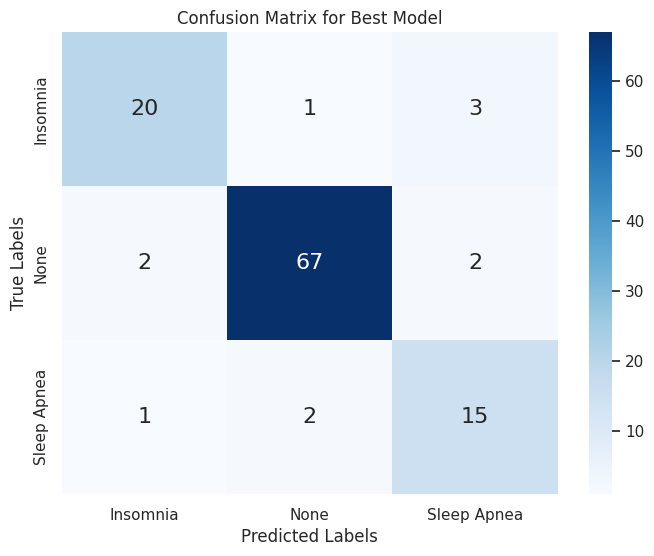

In [ ]:
from sklearn.metrics import confusion_matrix

y_pred = best_model.predict(X_test)
cm = confusion_matrix(y_test, y_pred)

# Vẽ Confusion Matrix cho Logistic Regression
class_labels = ["Insomnia", "None", "Sleep Apnea"]
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', annot_kws={"size": 16},
            xticklabels=class_labels, yticklabels=class_labels)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix for Best Model')
plt.show()

In [ ]:
from sklearn.metrics import classification_report
# Dự đoán trên tập kiểm thử
y_pred = best_model.predict(X_test)
# Tính classification report
report = classification_report(y_test, y_pred)
print(report)

              precision    recall  f1-score   support

           0       0.87      0.83      0.85        24
           1       0.96      0.94      0.95        71
           2       0.75      0.83      0.79        18

    accuracy                           0.90       113
   macro avg       0.86      0.87      0.86       113
weighted avg       0.91      0.90      0.90       113

